In [1]:
import sys
sys.path.append('../../')

In [2]:
from obelix_ml_pipeline.predictions_on_partially_seen_substrate import predict_partially_seen_substrate
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
import matplotlib.pyplot as plt
import numpy as np

# Objective 2: With a few data (as little as possible, max 96, i.e. half of the data) obtained for a complete new substrate, the model gives us the performance or a ranking of the remaining ligands

Methodology:
Classification on activity, regression on ee
Train on SM3, SM8 and a subset of SM7 (from 12 random data points up to 154 datapoints (80%)) --> Predict the rest of the ligands for SM7



## Example application of pipeline

Training and testing classifier
Test size in training (based on K-fold): 0.2
Mean test performance: 0.77 +/- 0.04
Best model performance: 0.99
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 3, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 100}
Test set performance balanced_accuracy:  0.7697368421052632
Test set confusion matrix:  [[15  4]
 [ 5 15]]


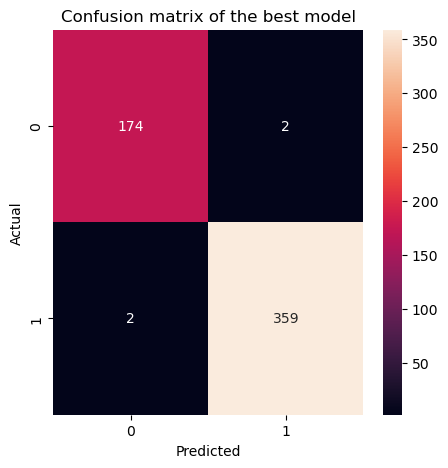

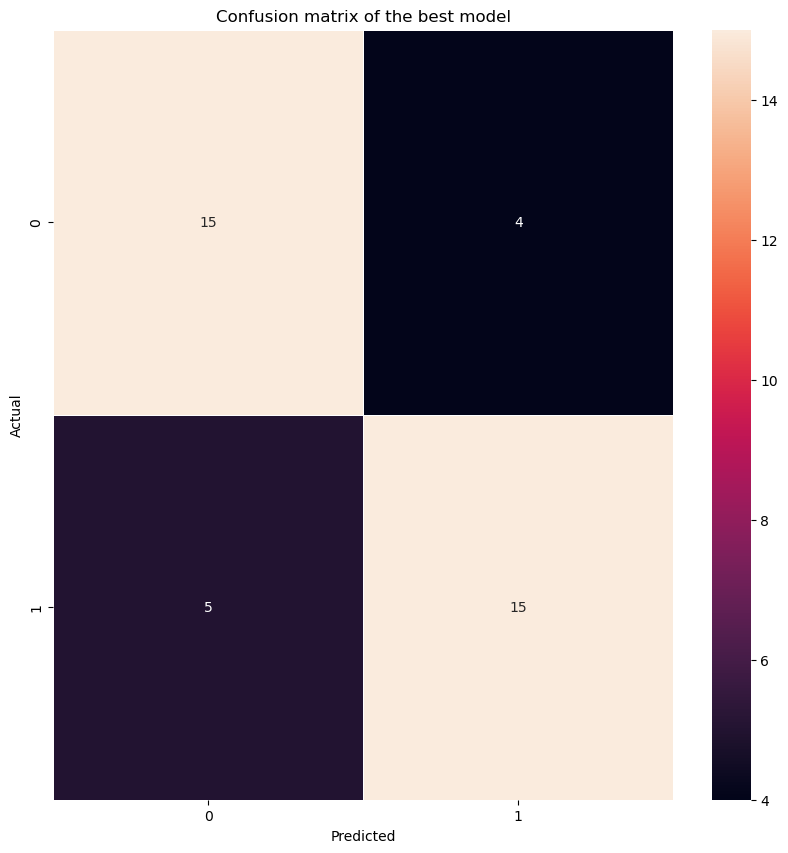

In [3]:
# try classifier with loaded representations
selected_ligand_representations = ['dft_nbd_model']
selected_substrate_representations = ['ecfp']
target = 'Conversion'
target_threshold = 0.8
rf_model = RandomForestClassifier(random_state=42)
scoring = 'balanced_accuracy'
train_splits = 5
n_jobs = 4
binary = True
plot_dendrograms = False
substrate_names_column = 'Substrate'
ligand_numbers_column = 'Ligand#'
list_of_training_substrates = ['SM2', 'SM8']
subset_substrate = 'SM7'
subset_size = 0.8  # 80% of data for subset substrate is used for addition to training set, the rest is used for testing
print_ml_results = True
print('Training and testing classifier')
print(f'Test size in training (based on K-fold): {1/train_splits}')
res = predict_partially_seen_substrate(selected_ligand_representations, selected_substrate_representations,
                                ligand_numbers_column, substrate_names_column, target, target_threshold, train_splits, binary,
                                list_of_training_substrates, subset_substrate, subset_size, rf_model, scoring, print_ml_results, n_jobs, plot_dendrograms)



In [4]:
res.fig_fi

Training and testing regression
Test size: 0.2
Mean test performance: 0.32 +/- 0.04
Best model performance: 0.94
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Test set performance r2:  0.28631867578178405


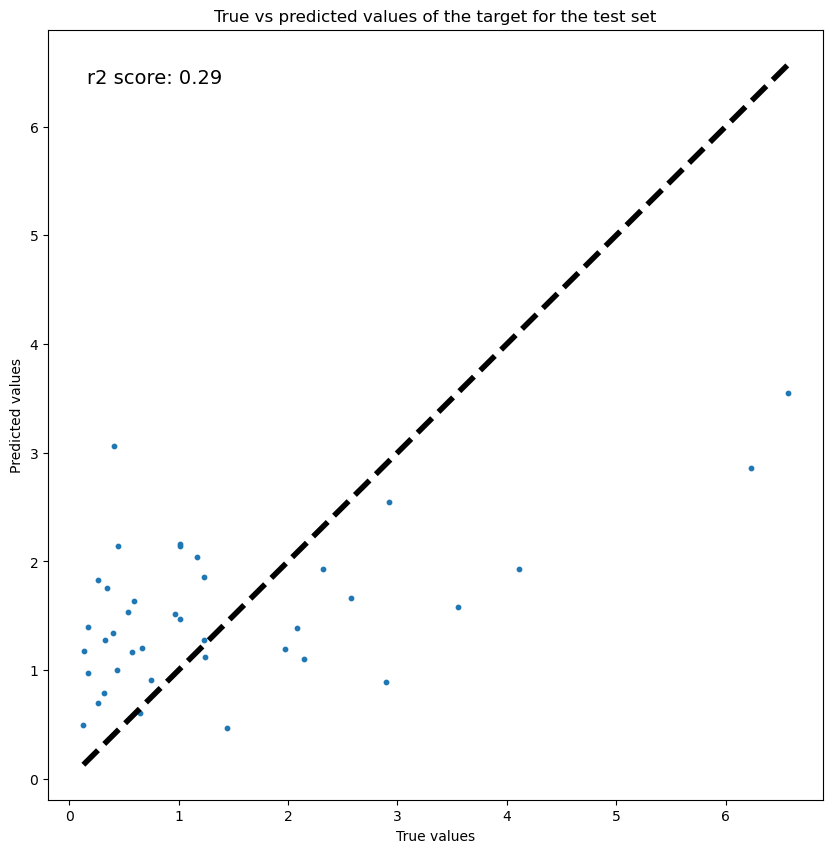

In [5]:
# try regression with loaded representations
target = 'DDG'
target_threshold = 0.6
rf_model = RandomForestRegressor(random_state=42)
scoring = 'r2'
binary = False
print('Training and testing regression')
print(f'Test size: {1 / train_splits}')
res = predict_partially_seen_substrate(selected_ligand_representations, selected_substrate_representations,
                                ligand_numbers_column, substrate_names_column, target, target_threshold, train_splits, binary,
                                list_of_training_substrates, subset_substrate, subset_size, rf_model, scoring, print_ml_results, n_jobs, plot_dendrograms)

In [6]:
res.fig_fi

## Test effect of subset size on performance for various substrates/ligands

dft_nbd_model + smiles_steric_fingerprint
Using 0.1 of data for subset substrate
Mean test performance: 0.73 +/- 0.03
Best model performance: 1.00
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 50}
Test set performance balanced_accuracy:  0.677358994921144
Test set confusion matrix:  [[43 44]
 [12 74]]
Using 0.2 of data for subset substrate
Mean test performance: 0.74 +/- 0.02
Best model performance: 1.00
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 3, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 50}
Test set performance balanced_accuracy:  0.7012987012987013
Test set confusion matrix:  [[41 36]
 [10 67]]
Using 0.30000000000000004 of data for subset substrate
Mean test performance: 0.75 +/- 0.02
Best model performance: 0.98
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 3, 'min_samples_leaf': 2, 'min_samples_spli

/projects/home/cvalsecc/repo/obelix-ml-pipeline/obelix_ml_pipeline/notebooks/../../obelix_ml_pipeline/machine_learning.py:58: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



Mean test performance: 0.74 +/- 0.06
Best model performance: 1.00
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 5, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}
Test set performance balanced_accuracy:  0.732554657082959
Test set confusion matrix:  [[44  9]
 [23 40]]
Using 0.5 of data for subset substrate
Mean test performance: 0.75 +/- 0.06
Best model performance: 0.99
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 5, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 50}
Test set performance balanced_accuracy:  0.7619047619047619
Test set confusion matrix:  [[36  6]
 [18 36]]
Using 0.6 of data for subset substrate
Mean test performance: 0.75 +/- 0.05
Best model performance: 1.00
Best model parameters: {'bootstrap': False, 'max_depth': 50, 'max_features': 3, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 50}
Test set performance balanced_accuracy:  0.7024623803009575
Test set

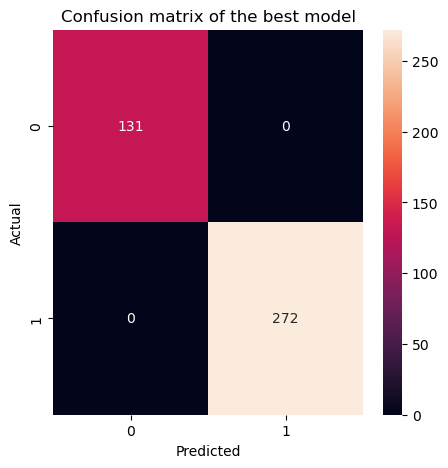

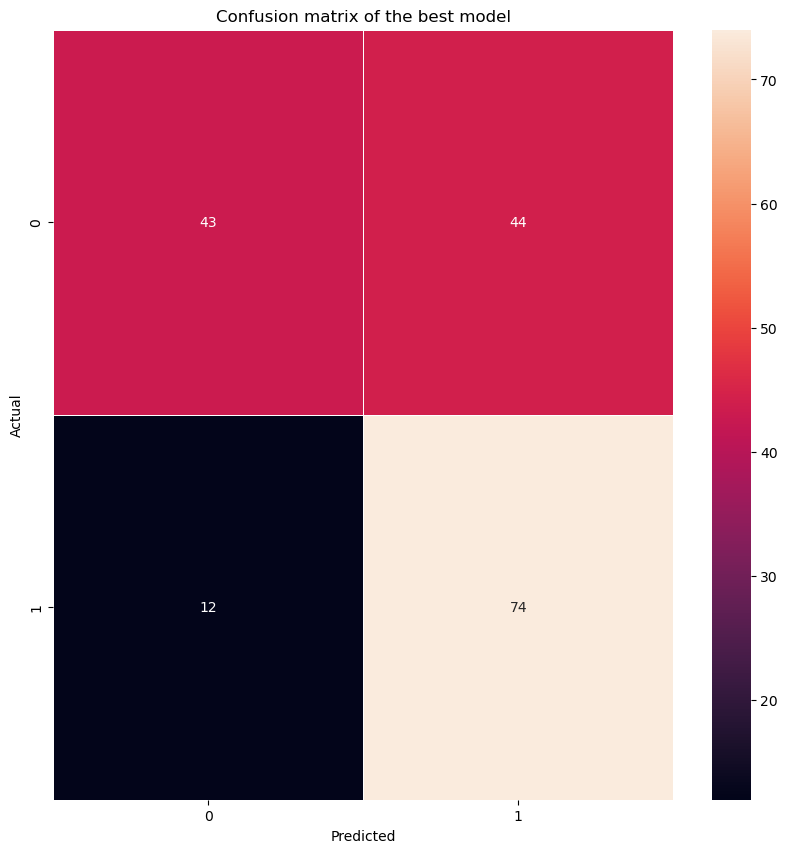

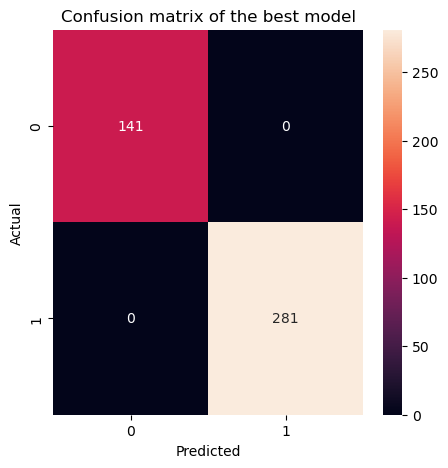

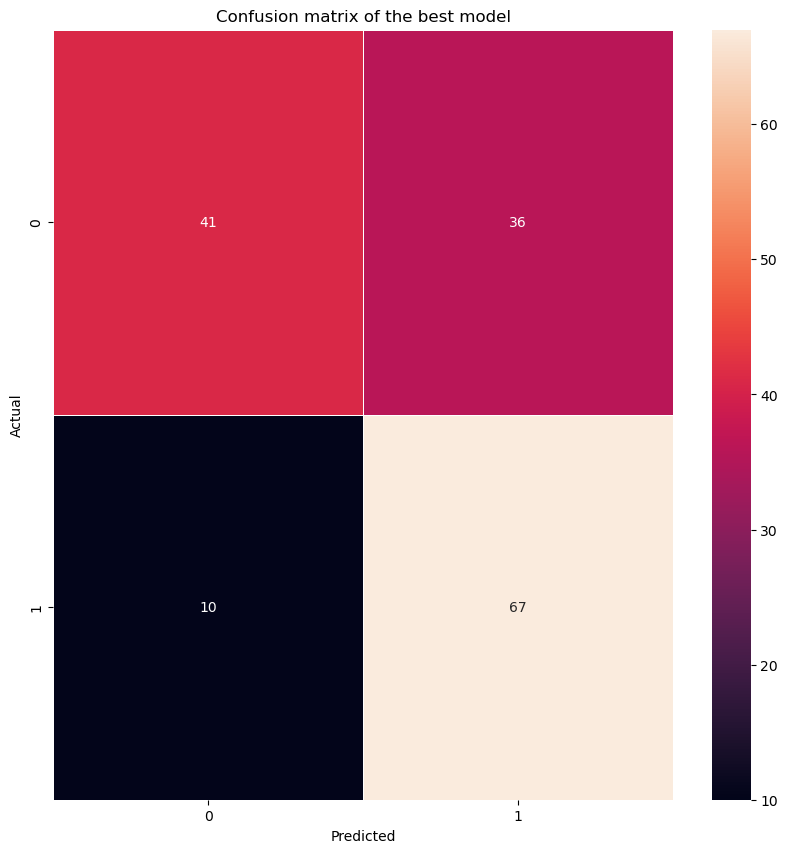

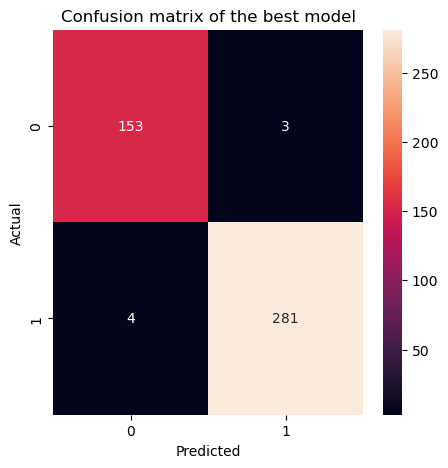

...

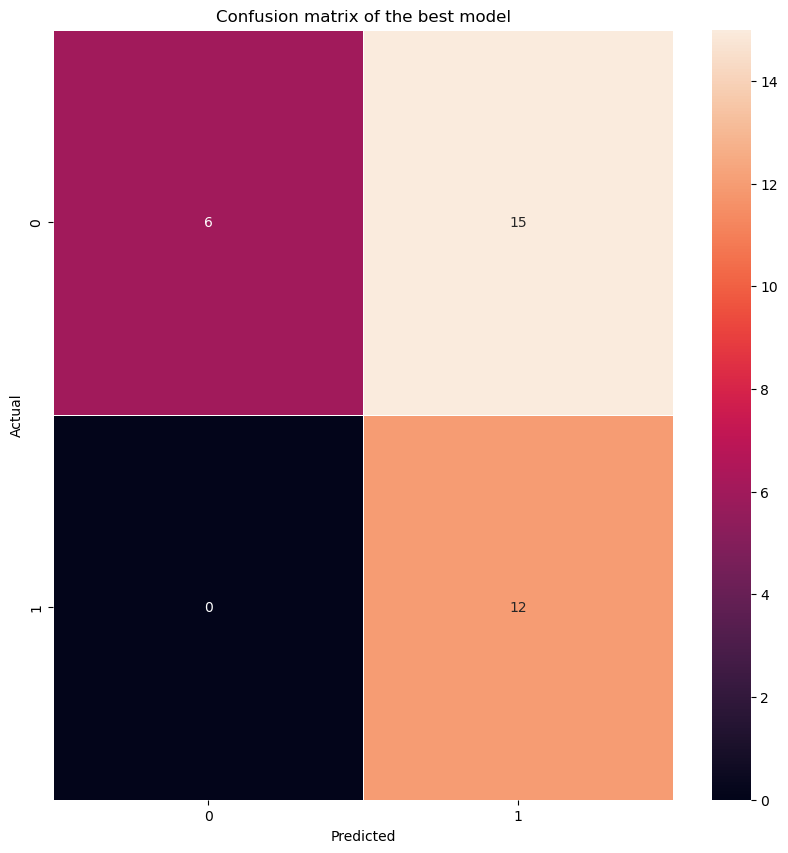

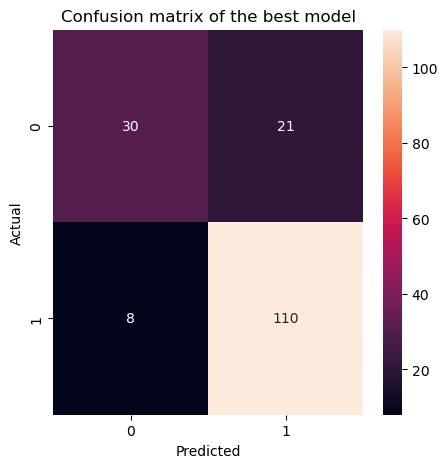

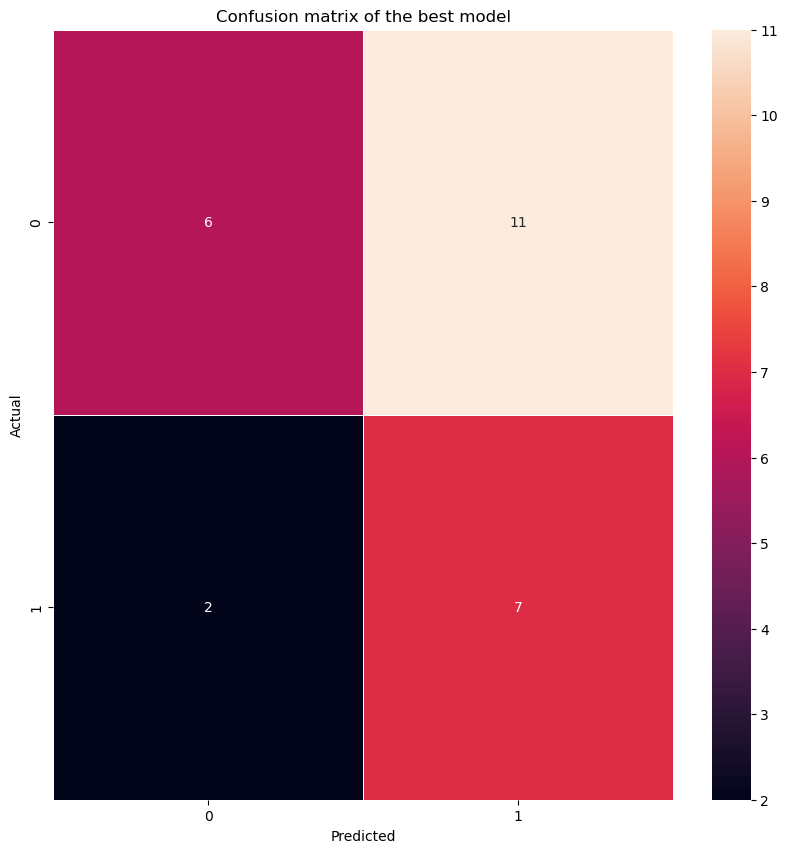

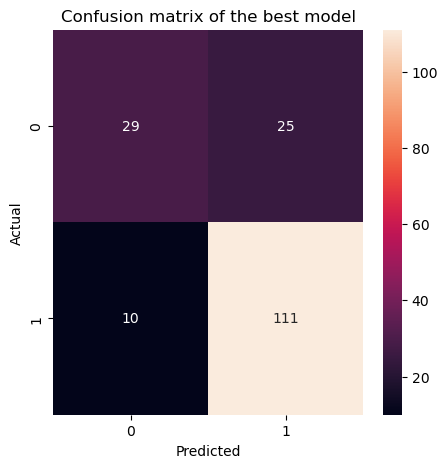

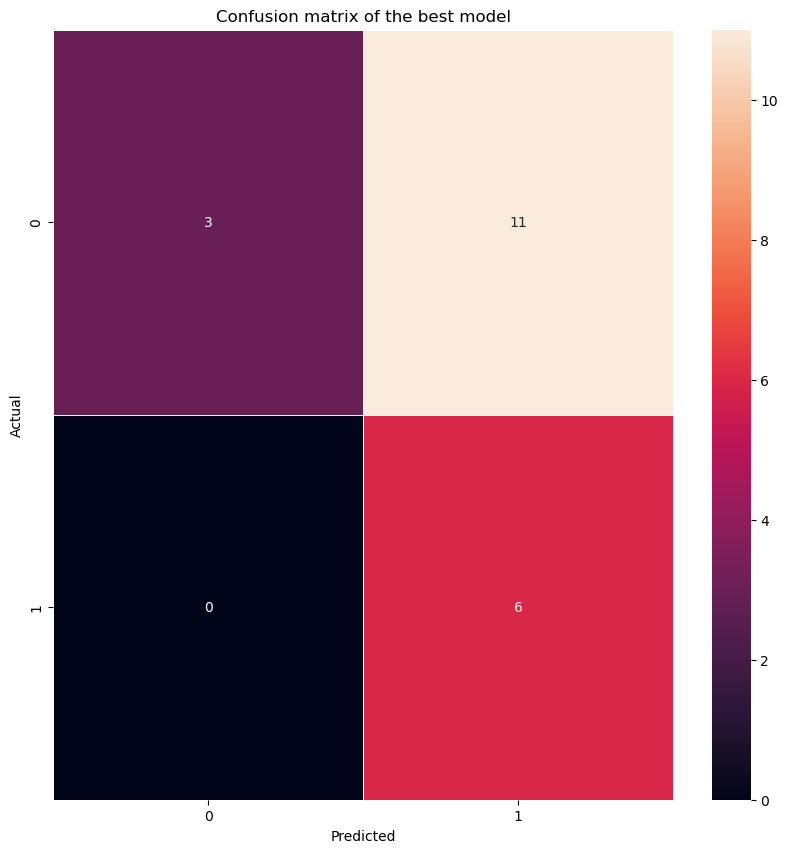

In [27]:
import pandas as pd
from obelix_ml_pipeline.representation_variables import AVAILABLE_LIGAND_REPRESENTATION_TYPES, AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES

target = 'Conversion'
target_threshold = 0.8
scoring = 'balanced_accuracy'
train_splits = 5
n_jobs = 4
binary = True
plot_dendrograms = False
substrate_names_column = 'Substrate'
ligand_numbers_column = 'Ligand#'
list_of_training_substrates = ['SM3', 'SM8']
subset_substrate = 'SM7'
print_ml_results = True
subset_sizes = np.arange(0.1, 0.9, 0.1)

# loop over all substrate/ligand representations
# collect mean and std of test performance during training per representation for plotting
list_of_test_scores_mean = []
list_of_test_scores_std = []
test_performance = []
res_df = pd.DataFrame(np.zeros((len(AVAILABLE_LIGAND_REPRESENTATION_TYPES),len(AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES))), 
             index = AVAILABLE_LIGAND_REPRESENTATION_TYPES,
            columns = AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES).astype(object)

for selected_ligand_representations in AVAILABLE_LIGAND_REPRESENTATION_TYPES:
    
    list_of_test_scores_mean_l = []
    list_of_test_scores_std_l = []
    test_performance_l = []

    for selected_substrate_representations in AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES[1:]:
        print(f'{selected_ligand_representations} + {selected_substrate_representations}')
        list_of_test_scores_mean_ls = []
        list_of_test_scores_std_ls = []
        test_performance_ls = []
        
        for subset_size in subset_sizes:
            rf_model = RandomForestClassifier(random_state=42)
            print(f'Using {subset_size} of data for subset substrate')
            res = predict_partially_seen_substrate([selected_ligand_representations], [selected_substrate_representations],
                                        ligand_numbers_column, substrate_names_column, target, target_threshold, train_splits, binary,
                                        list_of_training_substrates, subset_substrate, subset_size, rf_model, scoring, print_ml_results, n_jobs, plot_dendrograms)
            list_of_test_scores_mean_ls.append(res.training_test_scores_mean)
            list_of_test_scores_std_ls.append(res.training_test_scores_std)
            test_performance_ls.append(res.testing_performance_test)
        
        list_of_test_scores_mean_l.append(list_of_test_scores_mean_ls)
        list_of_test_scores_std_l.append(list_of_test_scores_std_ls)
        test_performance_l.append(test_performance_ls)
        
        res_df.loc[selected_ligand_representations,selected_substrate_representations]=test_performance_ls
        
    list_of_test_scores_mean.append(list_of_test_scores_mean_l)
    list_of_test_scores_std.append(list_of_test_scores_std_l)
    test_performance.append(test_performance_l)

In [37]:
res_conversion = res_df

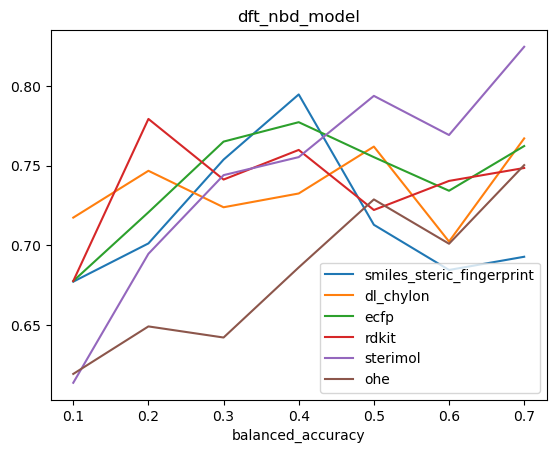

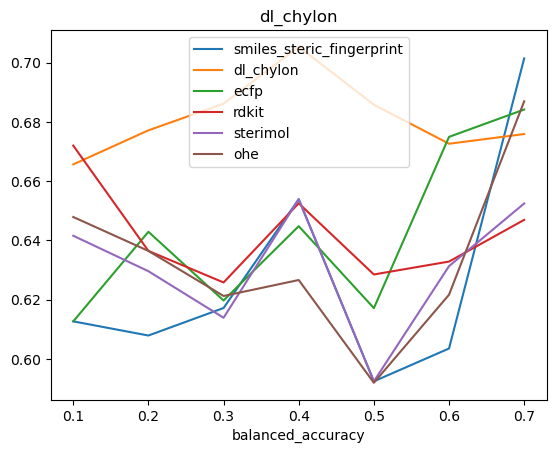

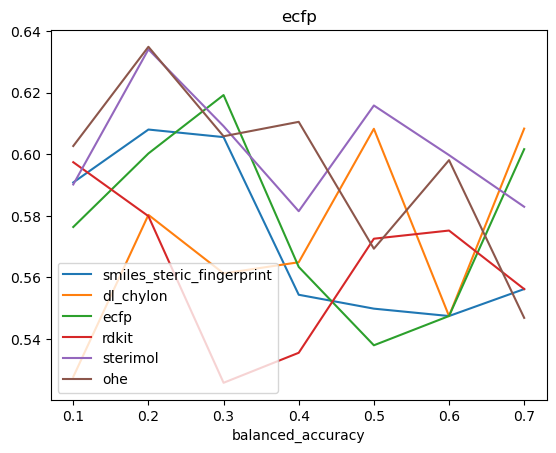

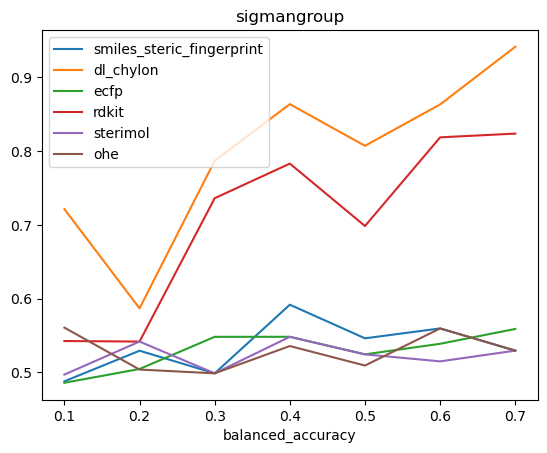

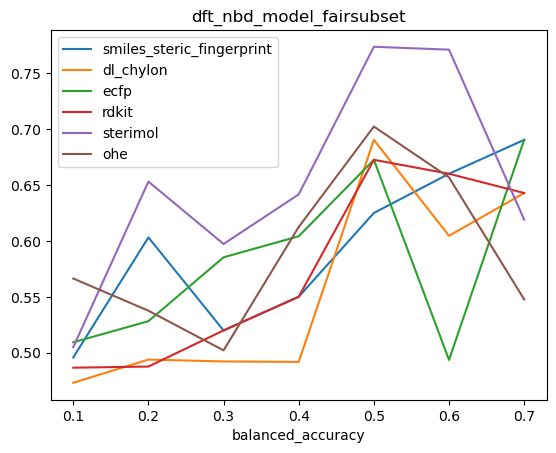

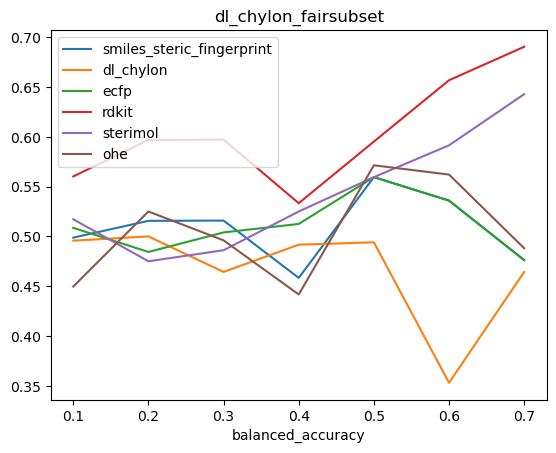

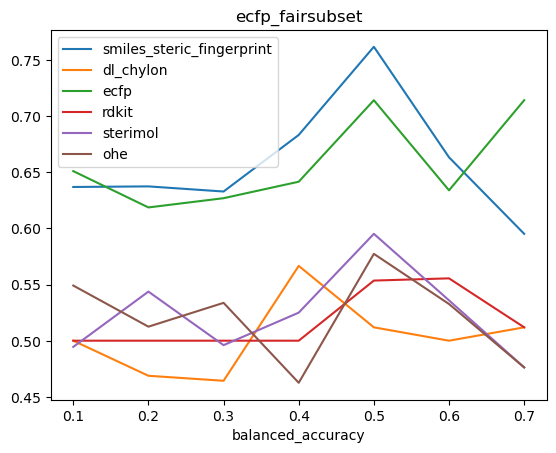

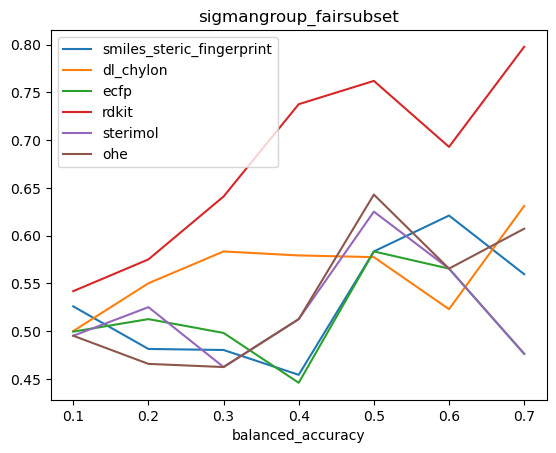

In [36]:
for idx,l in enumerate(AVAILABLE_LIGAND_REPRESENTATION_TYPES):
    for i in test_performance[idx]:
        plt.plot(subset_sizes, i)
    plt.title(l)
    plt.legend(AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES[1:])
    plt.xlabel('fraction included in training')
    plt.ylabel(scoring)
    plt.show()

In [41]:
test_performance

[[[0.0068034319301502055,
   0.23523340236370993,
   0.2218883796518607,
   0.18868399930221413,
   0.24989724228369292,
   0.2183233342154477,
   0.22904498092215464],
  [0.1221334895286379,
   0.14140895665724174,
   0.17006847962496552,
   0.11647612643158944,
   0.2524314433932202,
   0.22853738482090669,
   0.32565888410329114],
  [-0.05617694423093189,
   0.1679845502085704,
   0.22740352412723142,
   0.2142303282394793,
   0.2713471091796641,
   0.24023212008102257,
   0.1851555243357521],
  [0.09263358786314502,
   0.23947381327454154,
   0.19727526391679817,
   0.1729279395293204,
   0.22509242904022997,
   0.22846068899488015,
   0.2512086266886411],
  [-0.574233970178317,
   0.0509575515638655,
   0.06697211171151485,
   0.15164444879126737,
   0.12017812131210126,
   0.05600447835483613,
   -0.07093472064536233],
  [-1.1610698472376826,
   -0.3361583229190017,
   -0.05127834641203344,
   0.029727992838324835,
   0.07547290671441365,
   -0.0005801905976734467,
   -0.26955347

dft_nbd_model + smiles_steric_fingerprint
Using 0.1 of data for subset substrate
Using 0.2 of data for subset substrate
Using 0.30000000000000004 of data for subset substrate
Using 0.4 of data for subset substrate
Using 0.5 of data for subset substrate
Using 0.6 of data for subset substrate
Using 0.7000000000000001 of data for subset substrate
dft_nbd_model + dl_chylon
Using 0.1 of data for subset substrate
Using 0.2 of data for subset substrate
Using 0.30000000000000004 of data for subset substrate
Using 0.4 of data for subset substrate
Using 0.5 of data for subset substrate
Using 0.6 of data for subset substrate
Using 0.7000000000000001 of data for subset substrate
dft_nbd_model + ecfp
Using 0.1 of data for subset substrate
Using 0.2 of data for subset substrate
Using 0.30000000000000004 of data for subset substrate
Using 0.4 of data for subset substrate
Using 0.5 of data for subset substrate
Using 0.6 of data for subset substrate
Using 0.7000000000000001 of data for subset substrate

/projects/home/cvalsecc/repo/obelix-ml-pipeline/obelix_ml_pipeline/notebooks/../../obelix_ml_pipeline/machine_learning.py:114: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



dft_nbd_model + rdkit
Using 0.1 of data for subset substrate
Using 0.2 of data for subset substrate
Using 0.30000000000000004 of data for subset substrate
Using 0.4 of data for subset substrate
Using 0.5 of data for subset substrate
Using 0.6 of data for subset substrate
Using 0.7000000000000001 of data for subset substrate
dft_nbd_model + sterimol
Using 0.1 of data for subset substrate
Using 0.2 of data for subset substrate
Using 0.30000000000000004 of data for subset substrate
Using 0.4 of data for subset substrate
Using 0.5 of data for subset substrate
Using 0.6 of data for subset substrate
Using 0.7000000000000001 of data for subset substrate
dft_nbd_model + ohe
Using 0.1 of data for subset substrate
Using 0.2 of data for subset substrate
Using 0.30000000000000004 of data for subset substrate
Using 0.4 of data for subset substrate
Using 0.5 of data for subset substrate
Using 0.6 of data for subset substrate
Using 0.7000000000000001 of data for subset substrate
dl_chylon + smiles_st

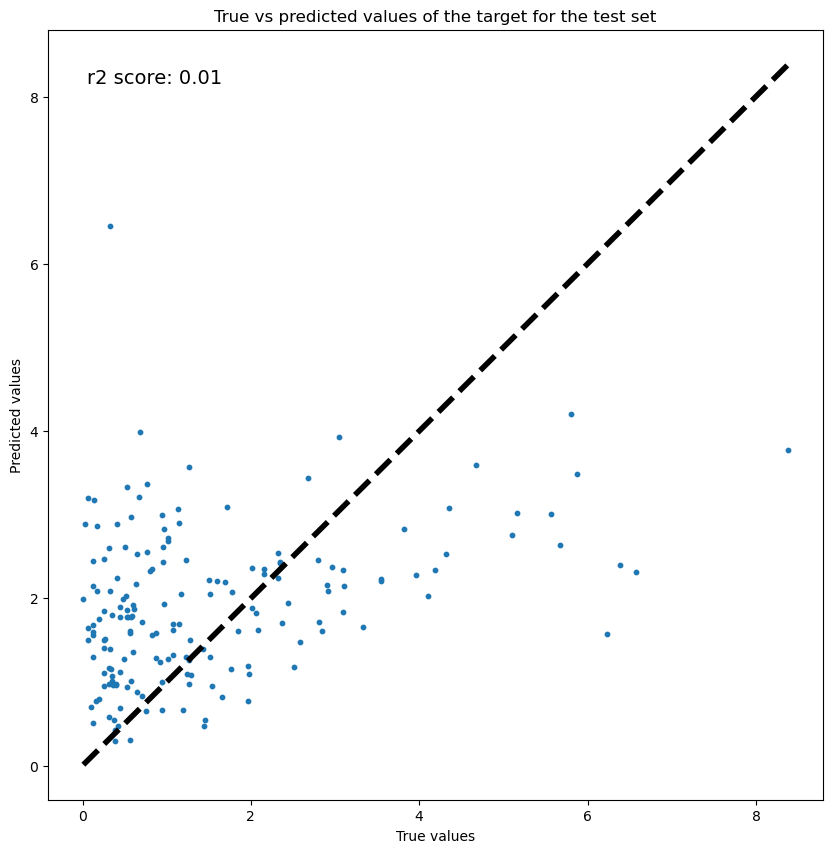

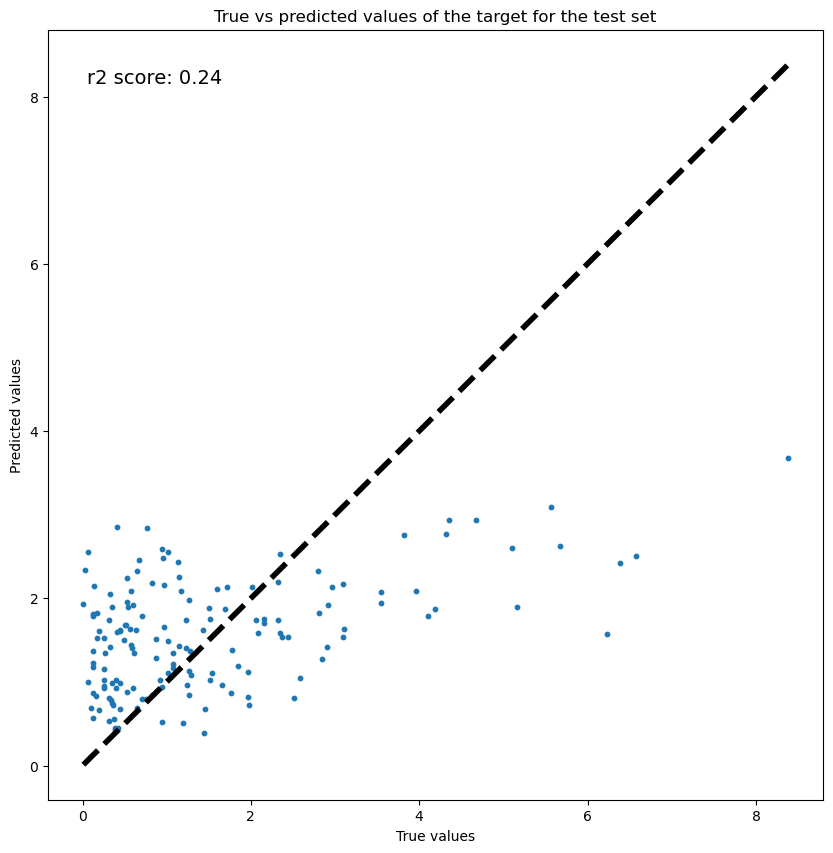

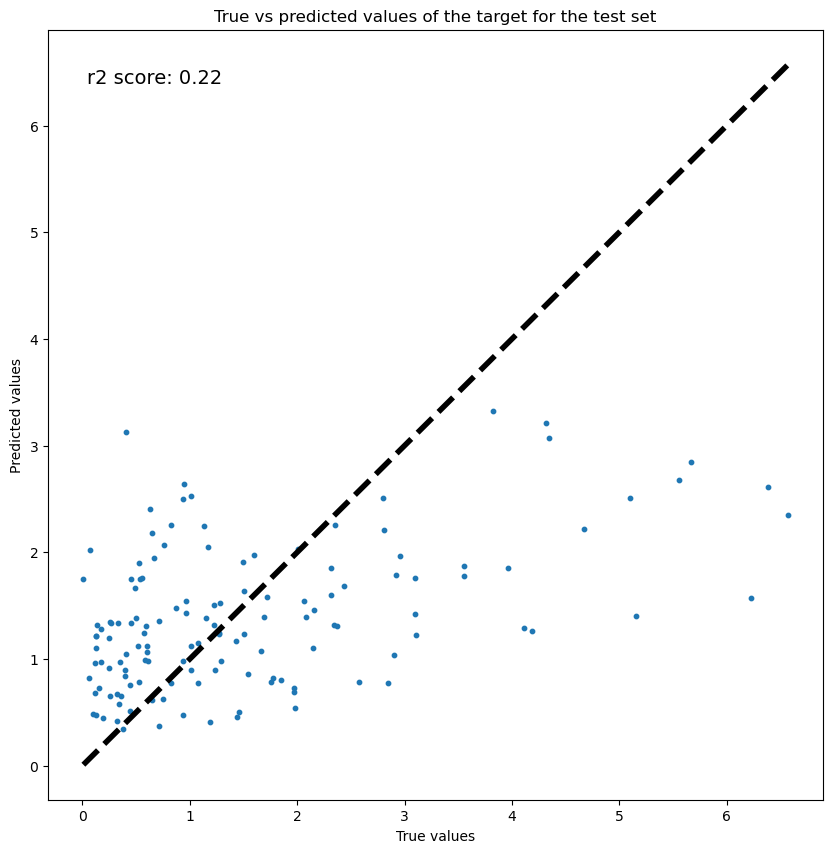

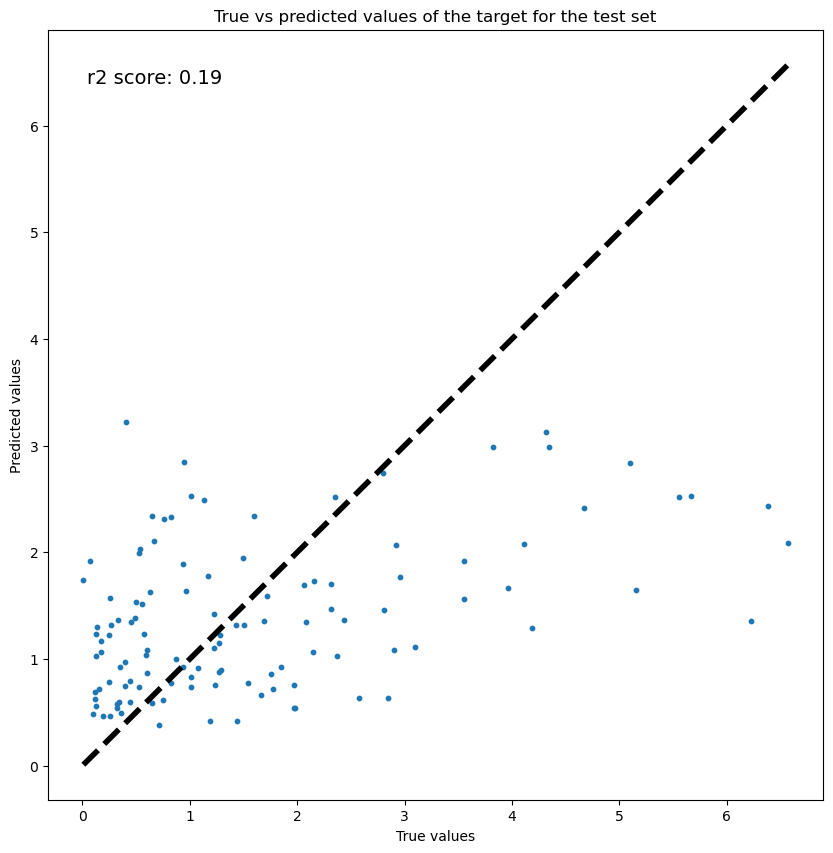

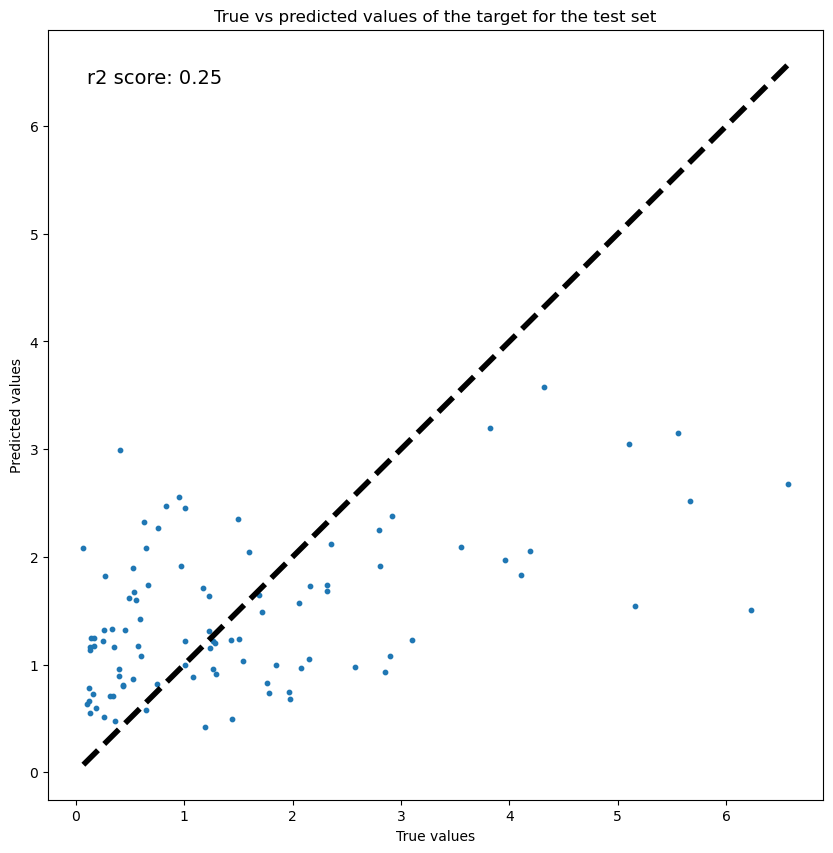

...

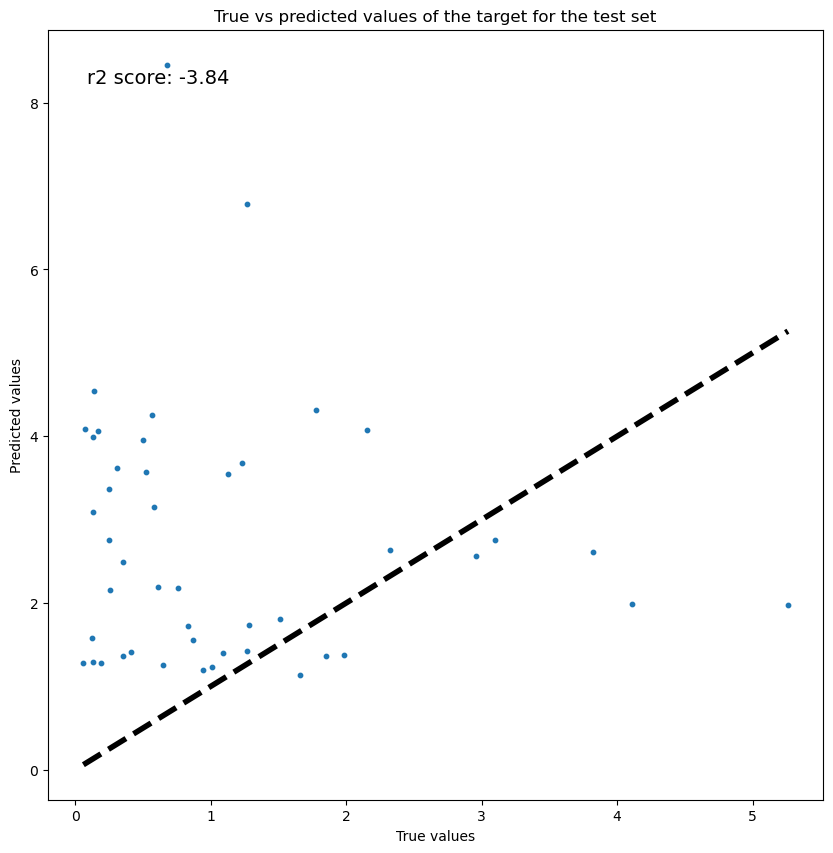

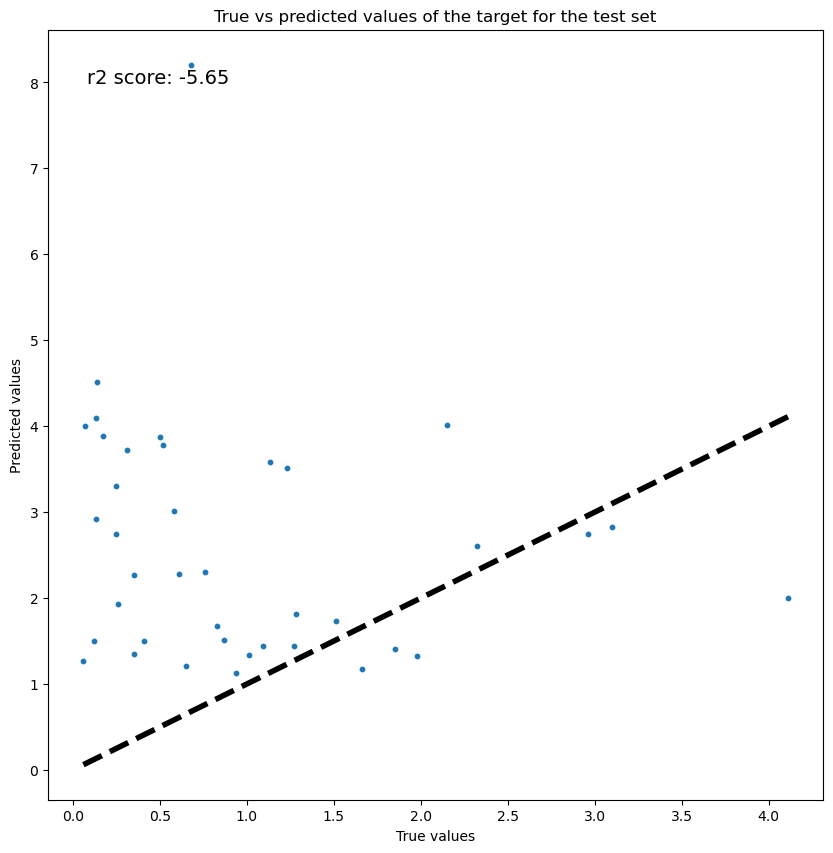

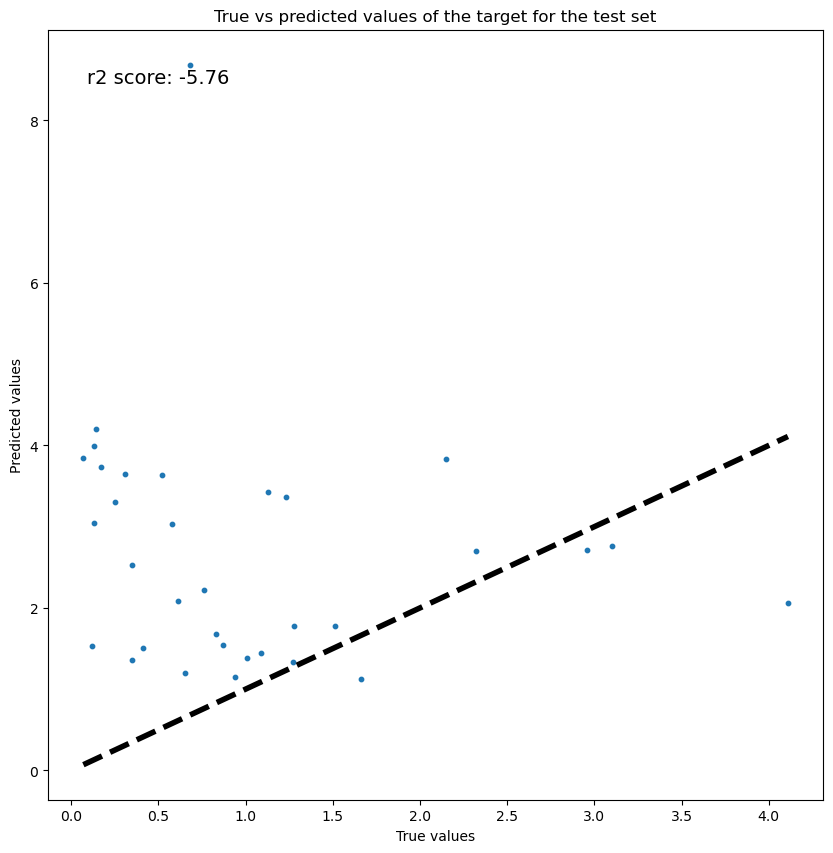

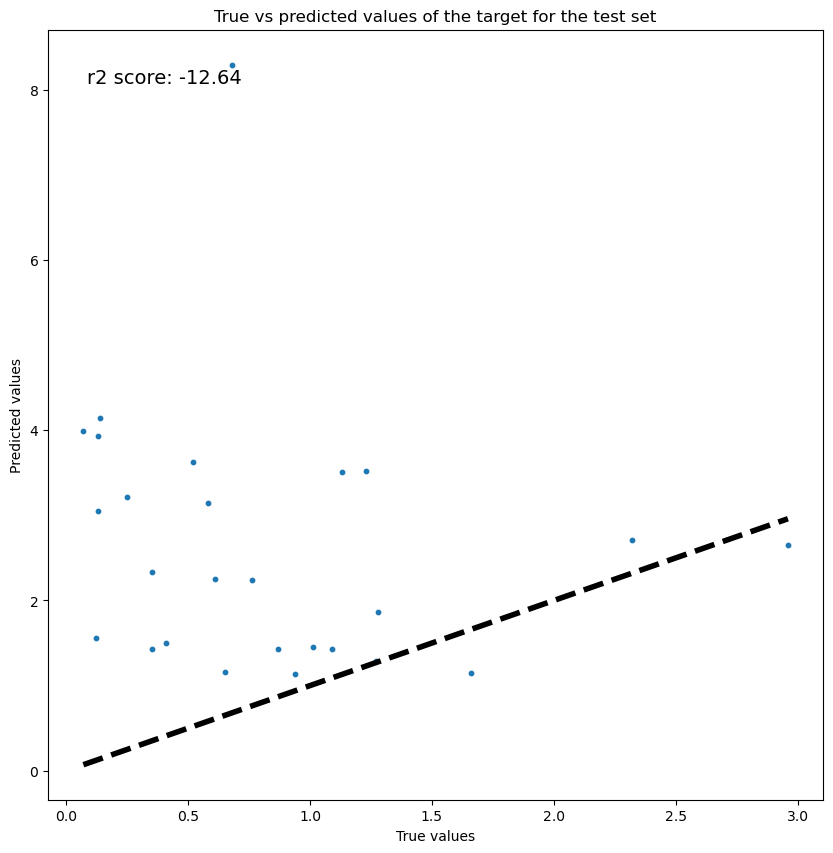

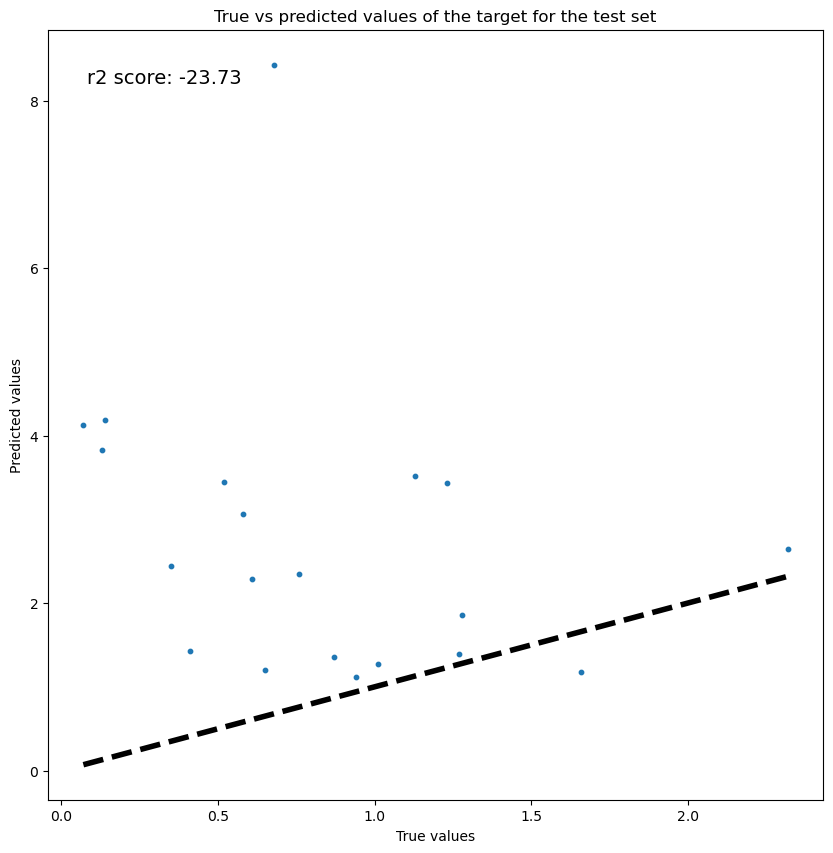

In [39]:
# try regression with loaded representations
target = 'DDG'
target_threshold = 0.6
scoring = 'r2'
train_splits = 5
n_jobs = 4
binary = False
plot_dendrograms = False
substrate_names_column = 'Substrate'
ligand_numbers_column = 'Ligand#'
list_of_training_substrates = ['SM3', 'SM8']
subset_substrate = 'SM7'
print_ml_results = False
subset_sizes = np.arange(0.1, 0.8, 0.1)

# loop over all substrate/ligand representations
# collect mean and std of test performance during training per representation for plotting
list_of_test_scores_mean = []
list_of_test_scores_std = []
test_performance = []
res_df = pd.DataFrame(np.zeros((len(AVAILABLE_LIGAND_REPRESENTATION_TYPES),len(AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES))), 
             index = AVAILABLE_LIGAND_REPRESENTATION_TYPES,
            columns = AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES).astype(object)

for selected_ligand_representations in AVAILABLE_LIGAND_REPRESENTATION_TYPES:
    
    list_of_test_scores_mean_l = []
    list_of_test_scores_std_l = []
    test_performance_l = []

    for selected_substrate_representations in AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES[1:]:
        print(f'{selected_ligand_representations} + {selected_substrate_representations}')
        list_of_test_scores_mean_ls = []
        list_of_test_scores_std_ls = []
        test_performance_ls = []
        
        for subset_size in subset_sizes:
            rf_model = RandomForestRegressor(random_state=42)
            print(f'Using {subset_size} of data for subset substrate')
            res = predict_partially_seen_substrate([selected_ligand_representations], [selected_substrate_representations],
                                ligand_numbers_column, substrate_names_column, target, target_threshold, train_splits, binary,
                                list_of_training_substrates, subset_substrate, subset_size, rf_model, scoring, print_ml_results, n_jobs, plot_dendrograms)
            list_of_test_scores_mean_ls.append(res.training_test_scores_mean)
            list_of_test_scores_std_ls.append(res.training_test_scores_std)
            test_performance_ls.append(res.testing_performance_test)
        
        list_of_test_scores_mean_l.append(list_of_test_scores_mean_ls)
        list_of_test_scores_std_l.append(list_of_test_scores_std_ls)
        test_performance_l.append(test_performance_ls)
        
        res_df.loc[selected_ligand_representations,selected_substrate_representations]=test_performance_ls
        
    list_of_test_scores_mean.append(list_of_test_scores_mean_l)
    list_of_test_scores_std.append(list_of_test_scores_std_l)
    test_performance.append(test_performance_l)

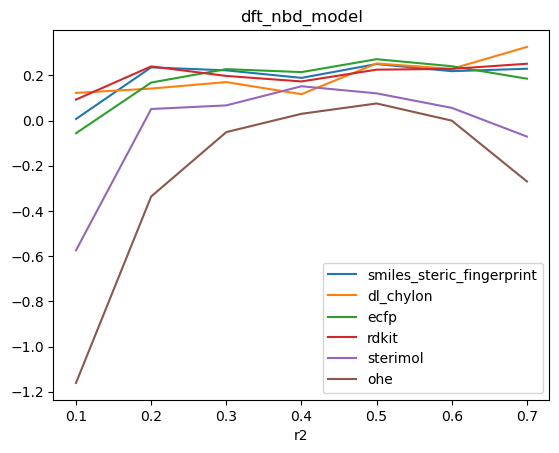

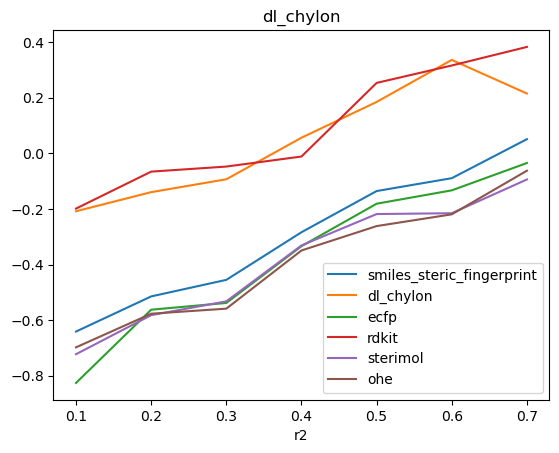

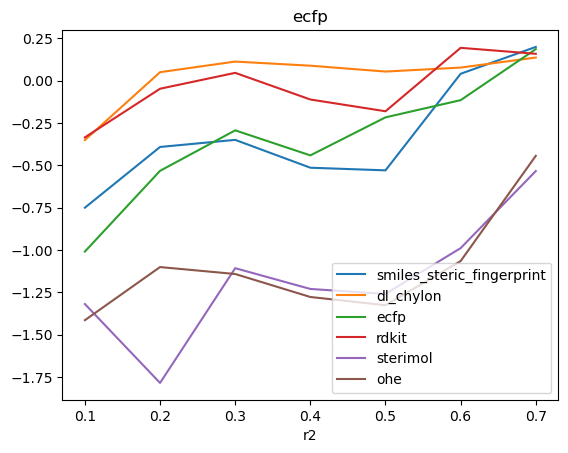

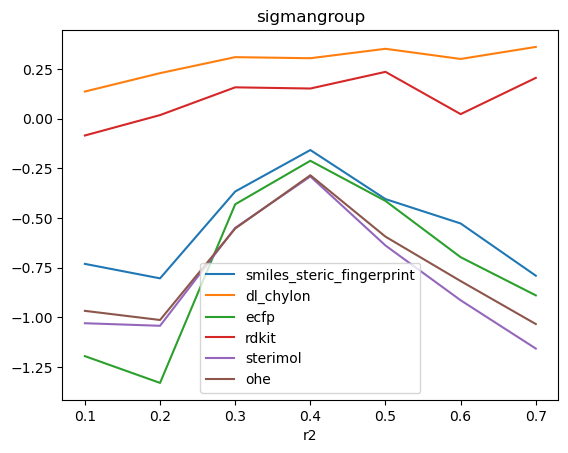

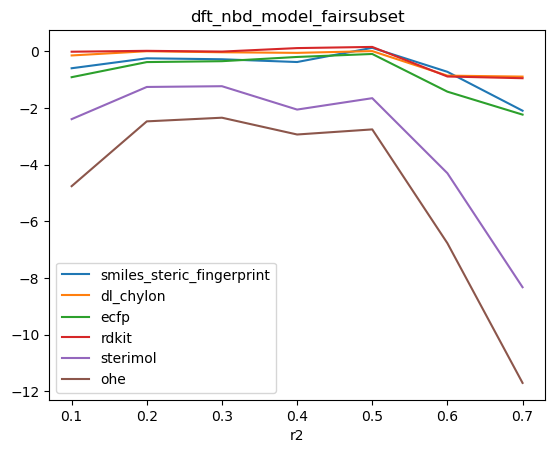

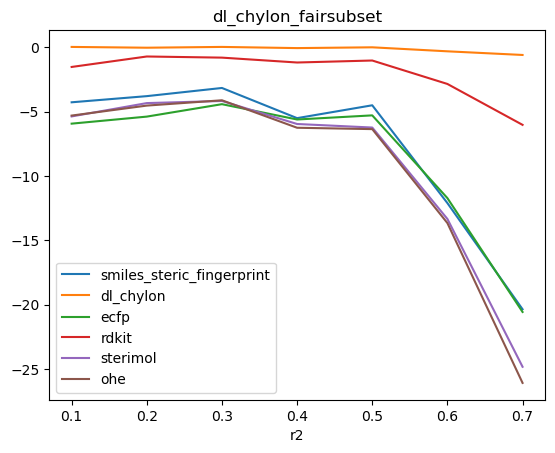

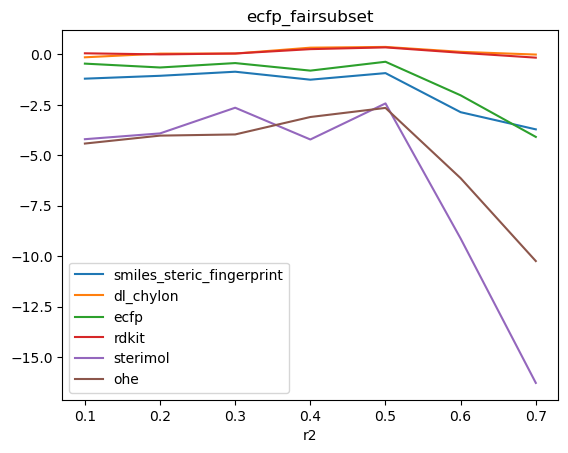

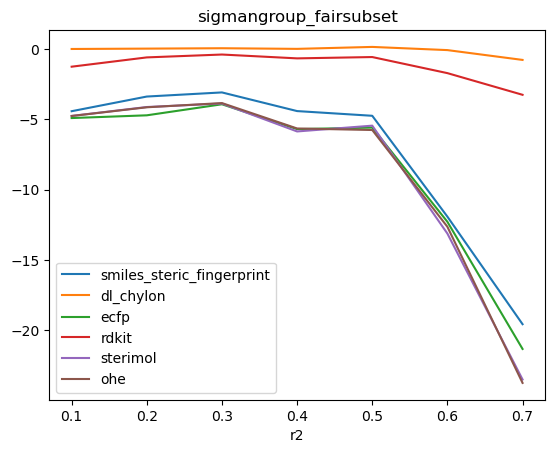

In [40]:
for idx,l in enumerate(AVAILABLE_LIGAND_REPRESENTATION_TYPES):
    for i in test_performance[idx]:
        plt.plot(subset_sizes, i)
    plt.title(l)
    plt.legend(AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES[1:])
    plt.xlabel('fraction included in training')
    plt.ylabel(scoring)
    plt.show()